## Pt.1 Hand_mask_generation
This script shows the step by step process to **create a set of masks of hand image** that will be used to create a image dataset for hand tracking on YOLO. At the end of the tutorial, we'd like to have a **set of segmented masks of hand with the corresponsing bounding boxes**(size and coordinates) saved in the local directory that can be later added to any images used for object detection model training.
I am processing two separate **videos** that recorded my hand in the black background to extract the hand mask.  

#### Please see the readme file to find the part2 of the tutorial where I create the full custom data set for yolo

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

We start by creating a helper function to show the image in-line.


In [2]:
def showimg(img, bgr=False, gray=False):
    """
    shows the image, being handled with opencv, in-line with matplotlib
    
    args:
        gray: Grayscale option (True or False)
        bgr: opencv flips RGB to BGR (True or False)
    """
    # Feel free to resize the figure size as necessary
    plt.figure(figsize = (8, 10))
    
    if bgr:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        imgplot = plt.imshow(img)
    elif gray:
        imgplot = plt.imshow(img, cmap='gray')
    else:    
        imgplot = plt.imshow(img)
    plt.show()

We'll need another helpfer function to grab contours per different openCV. I am running it on OpenCV 4.1.1

In [3]:
def get_contours(cnts):
    """
    checks the openCV version and returns the contours 
    """
    # if '2', it's OpenCV v2.4 or v4
    if len(cnts) == 2:
        cnts = cnts[0]
    # if '3', it's OpenCV v3,
    elif len(cnts) == 3:
        cnts = cnts[1]
    # Otherwise, raise error
    else:
        raise Exception(("Unknown Contour Length, Check the OpenCV version"))
    
    return cnts

### Step-by-step explanation with sample data
Read in the sample image, see the size of an image and show it in-line

In [4]:
image = mpimg.imread('../data/myhand/IMG_1578.jpg')
image.shape

(4032, 3024, 3)

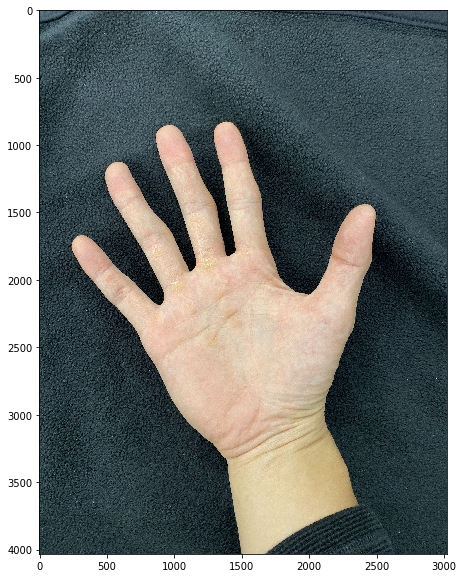

In [5]:
showimg(image)

Before extracting contours of an hand, we convert the images to grayscale

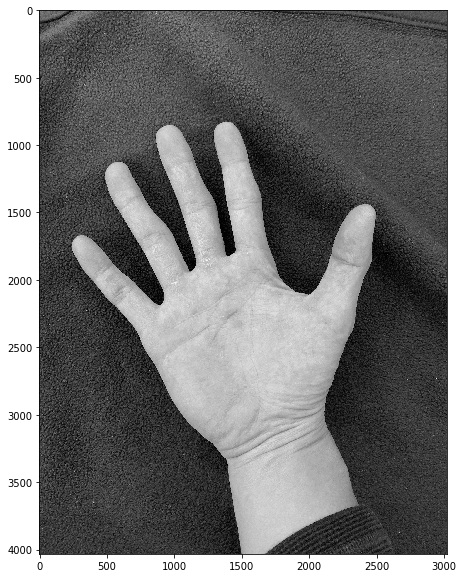

In [6]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
showimg(gray, gray=True)

My approach is to threshold the image to find the hand in the picture. You may want to play with the intensity values (0-255) to find right threshold

In [7]:
thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)[1]

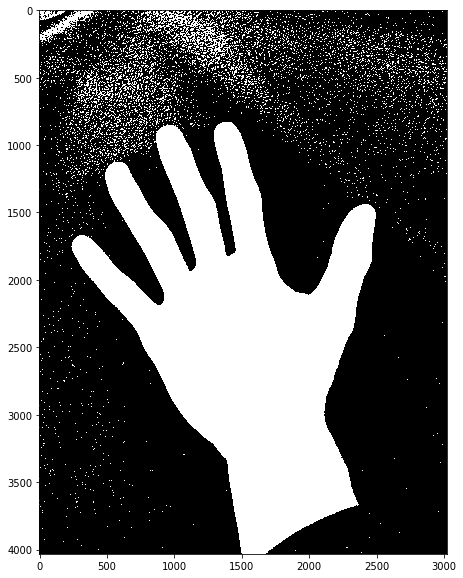

In [8]:
showimg(thresh, gray=True)

And now we get rid of the noise with erosion

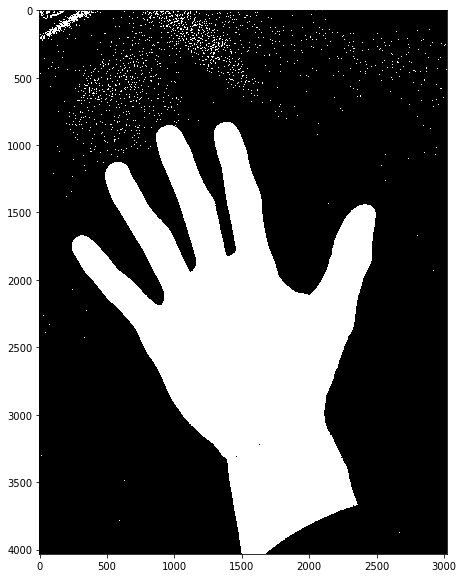

In [9]:
erode = cv2.erode(thresh, None, iterations=1)
showimg(erode, gray=True)

Now we find the contours from processed image

In [10]:
cnts = cv2.findContours(erode, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

We grab the contours with the helper function defined at the top

In [11]:
cnts = get_contours(cnts)

We find the contour of a hand assuming it has the largest area among all possible combinations of contours found by the `cv2.findContours`

In [12]:
c = max(cnts, key=cv2.contourArea)

Now we define the mask for extracted region for hand. One can use the `cv2.pointPolygonTest` that calculates the closest distance of a given point to the contour that eventually determins whether the point falls inside or outside of a contour, to create the mask. However, it's simpler to use an option to have contour fill up the inside with `cv2.FILLED` tag

In [17]:
mask = np.zeros((image.shape[:2]), dtype='uint8')

cv2.drawContours(mask, [c], -1, (1,0,0), cv2.FILLED)

masked = image.copy()
for i in range(3):
    masked[:,:,i] = masked[:,:,i] * (mask != 0)

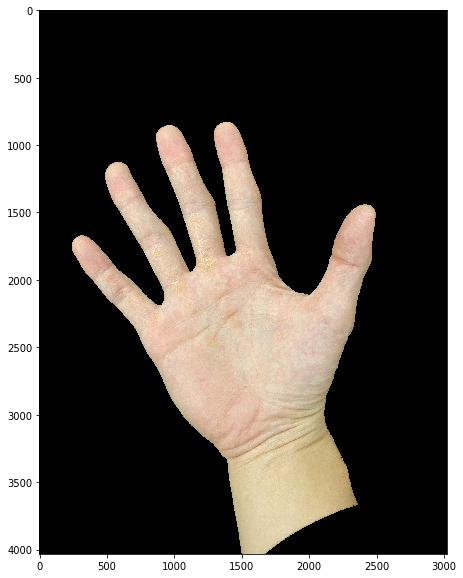

In [19]:
showimg(masked)

We now find the extreme points of contours for the bounding box

In [20]:
extLeft = tuple(c[c[:, :, 0].argmin()][0])
extRight = tuple(c[c[:, :, 0].argmax()][0])
extTop = tuple(c[c[:, :, 1].argmin()][0])
extBot = tuple(c[c[:, :, 1].argmax()][0])

cv2.rectangle(masked, (extLeft[0], extTop[1]), (extRight[0], extBot[1]), (255, 0, 0), thickness=10)

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

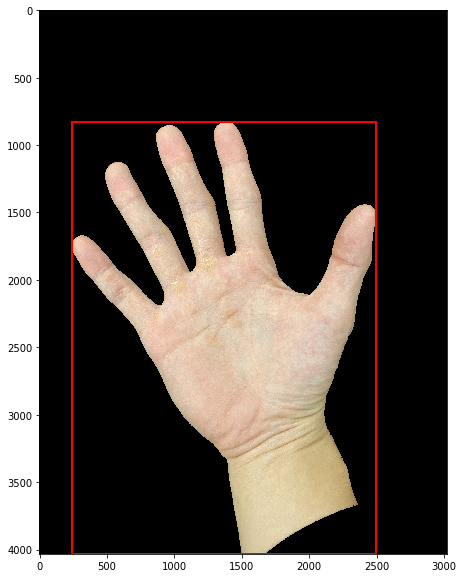

In [21]:
showimg(masked)

We will generate a text file that records the coordinates of extreme points so we can later crop the hand from each picture and disregard the empty spaces

### Putting everything together
Below snippet of the code takes the video files, processes the images to define the masks and save the images in `mask/` directory. 

In [33]:
!ls cd ../data/myhand/

ls: cannot access 'cd': No such file or directory
../data/myhand/:
COCO_train2014_000000000154.jpg  IMG_0341.MOV  IMG_2582.jpg  IMG_8259.jpg
IMG_0338.MOV			 IMG_1578.jpg  IMG_4116.jpg  mask


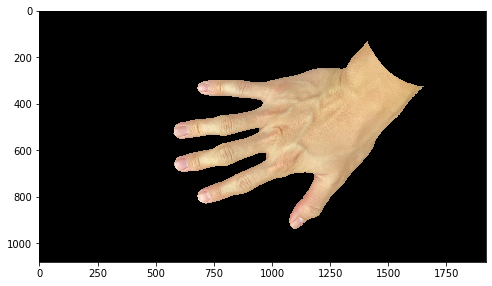

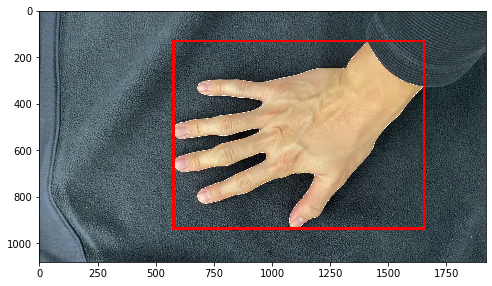

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_0.jpg


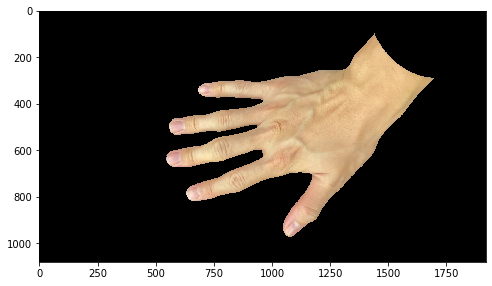

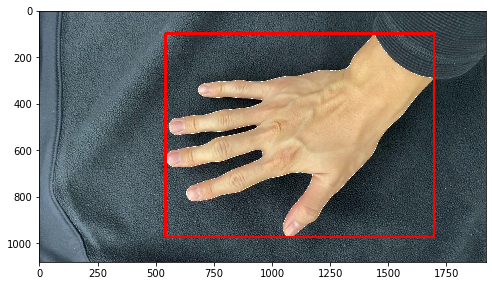

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_1.jpg


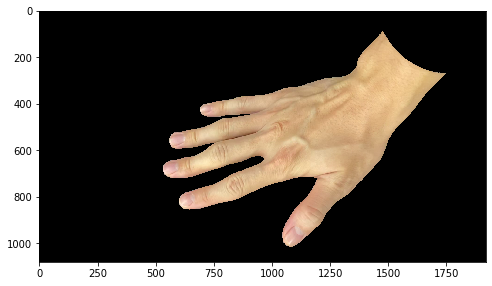

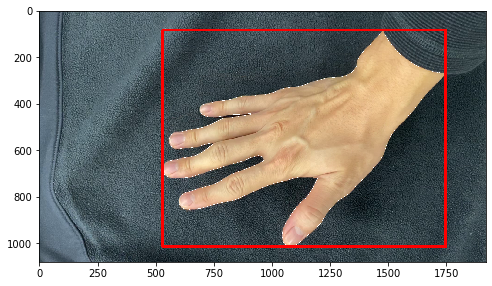

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_2.jpg


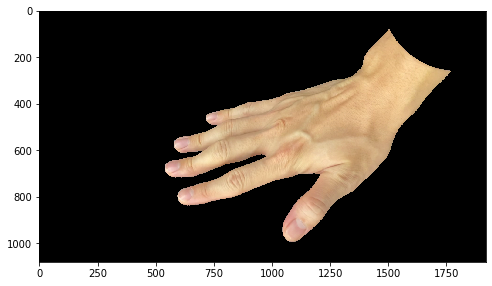

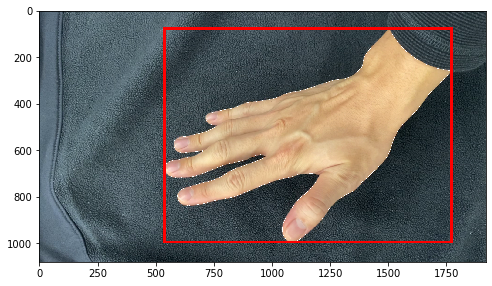

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_3.jpg


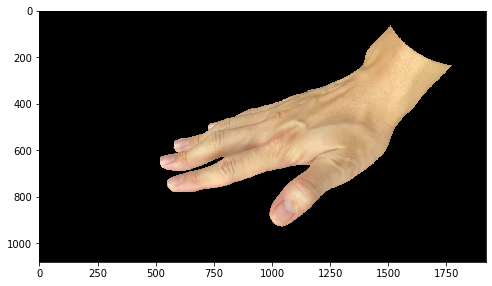

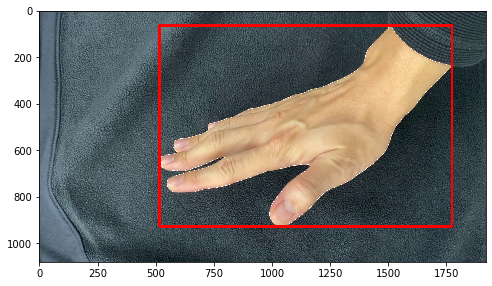

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_4.jpg


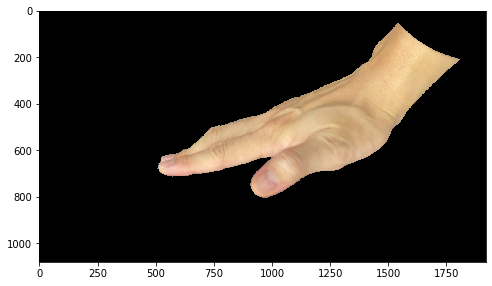

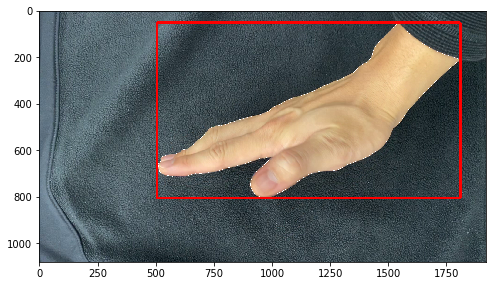

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_5.jpg


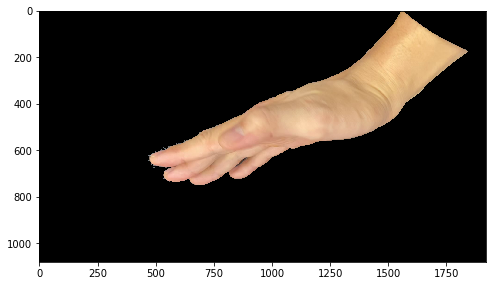

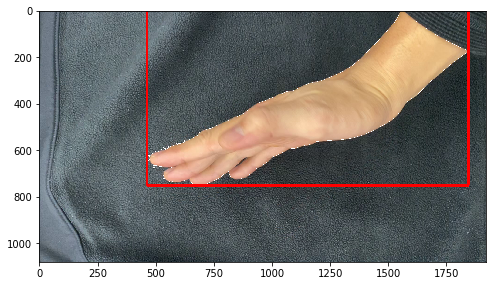

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_6.jpg


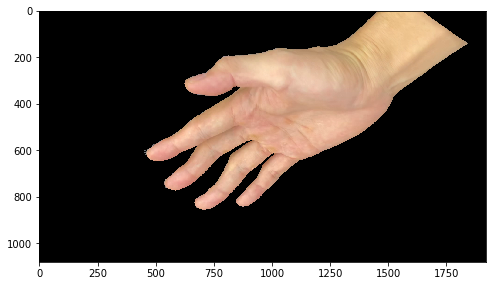

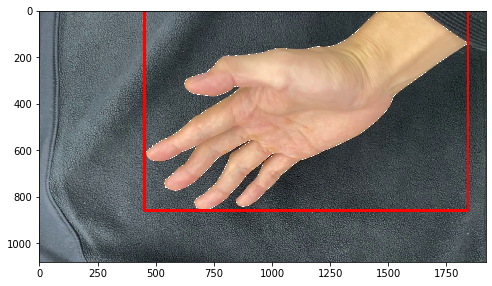

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_7.jpg


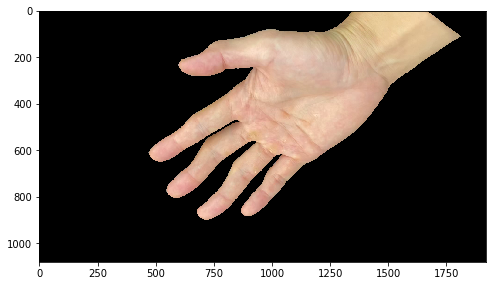

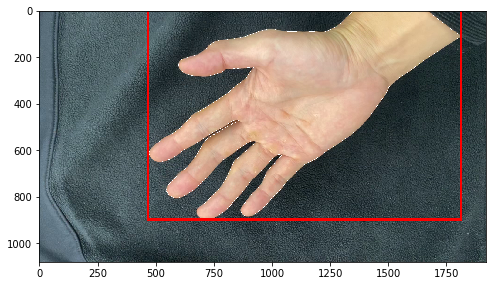

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_8.jpg


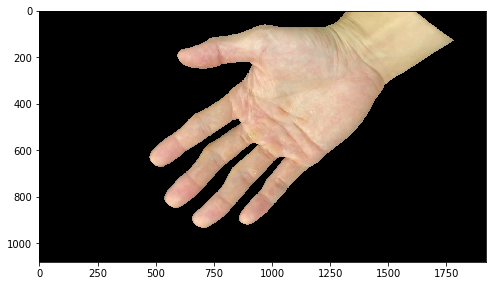

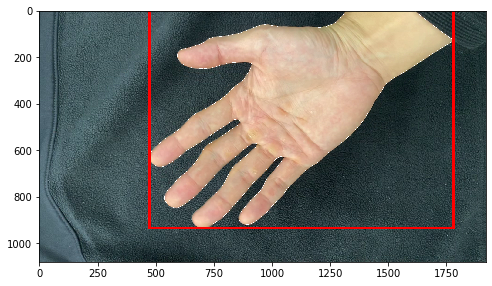

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_9.jpg


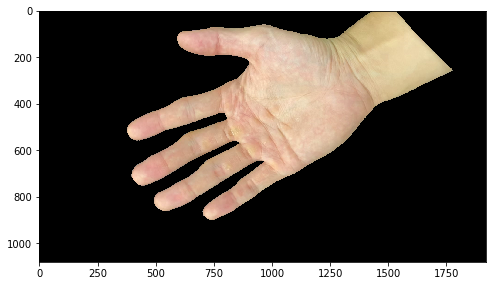

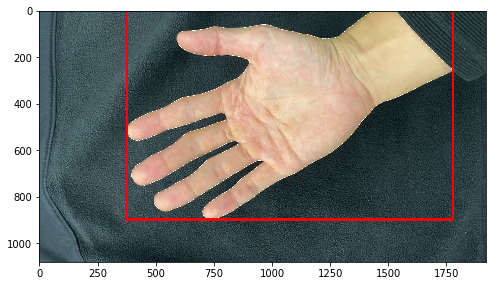

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_10.jpg


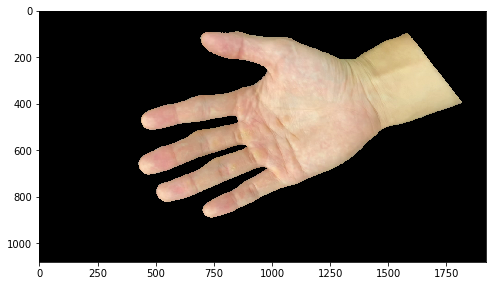

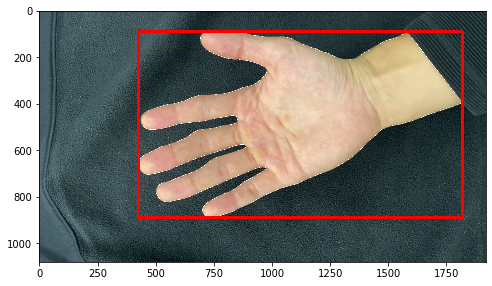

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_11.jpg


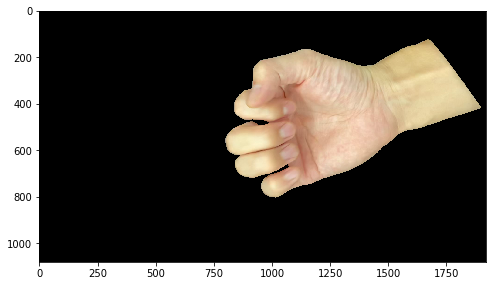

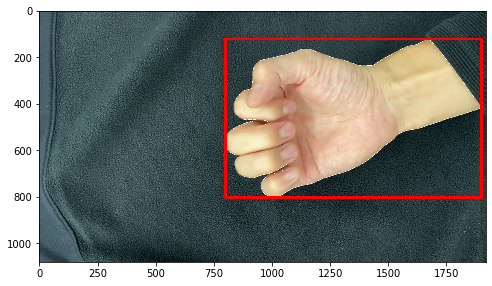

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_12.jpg


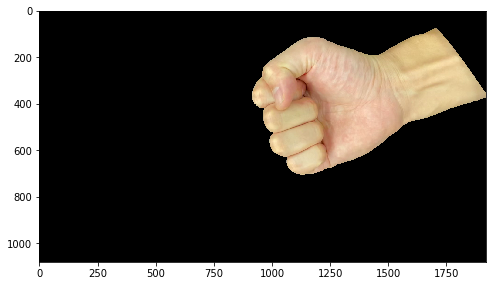

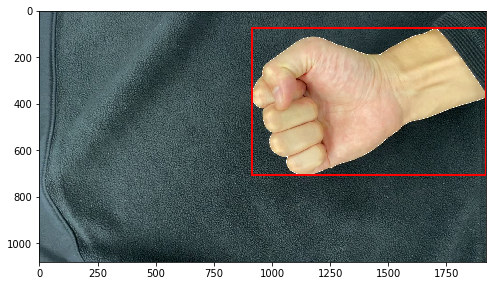

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_13.jpg


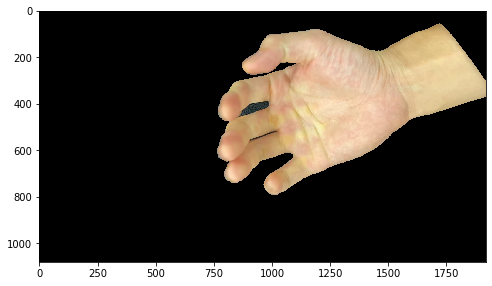

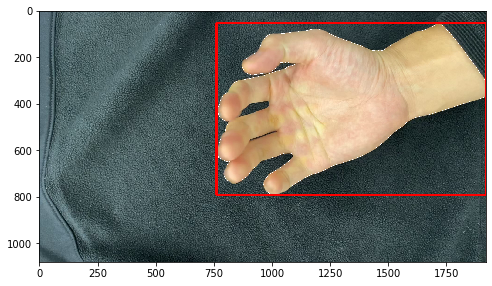

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_14.jpg


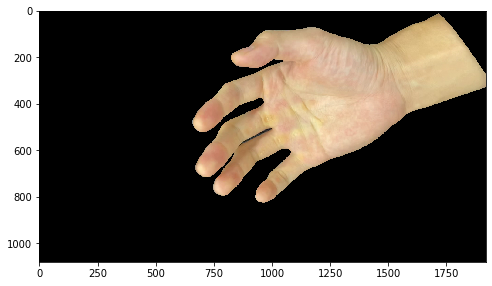

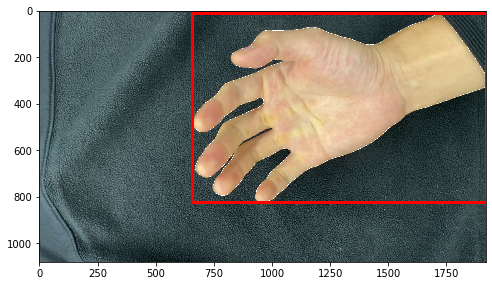

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_15.jpg


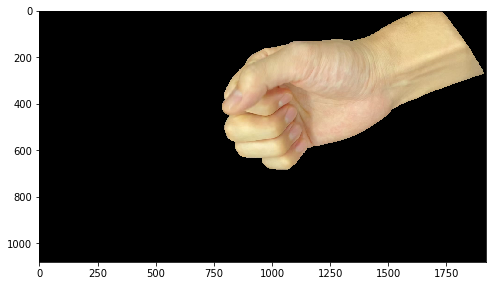

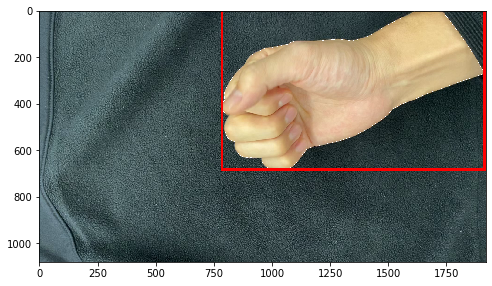

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_16.jpg


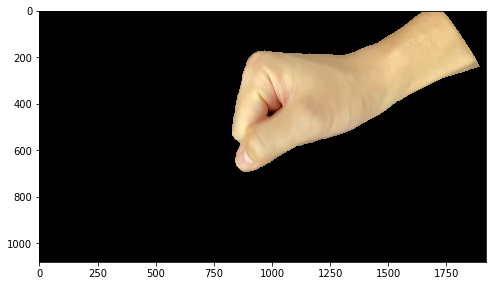

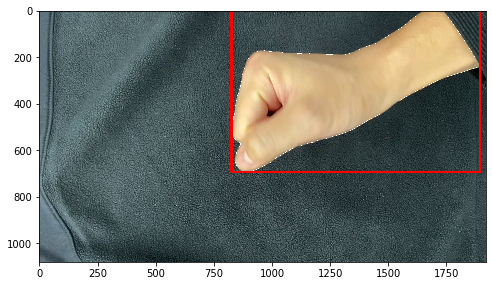

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_17.jpg


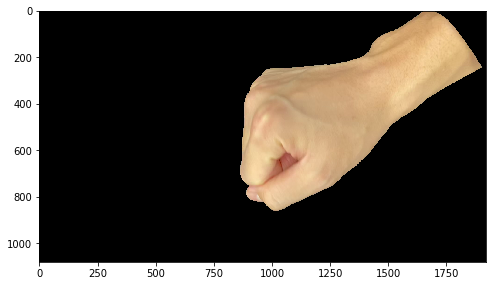

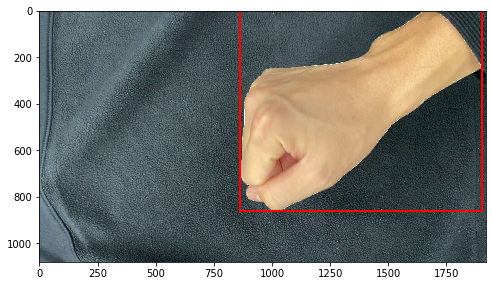

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_18.jpg


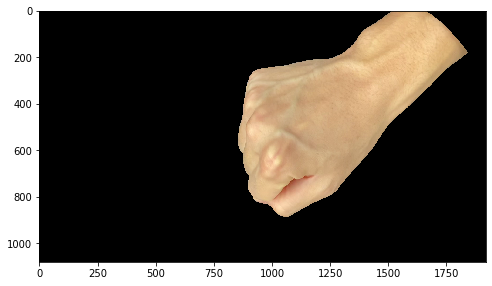

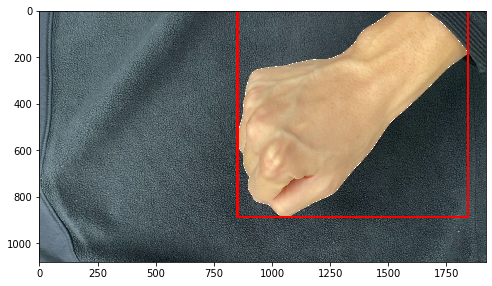

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_19.jpg


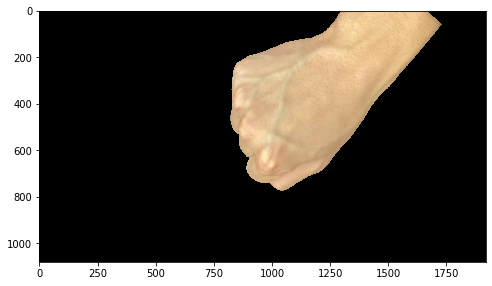

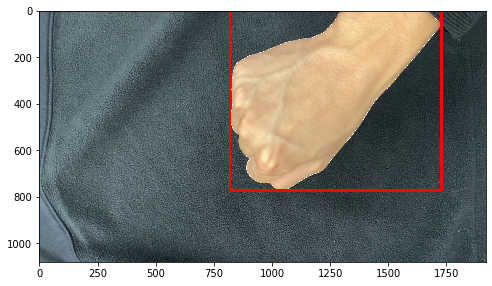

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_20.jpg


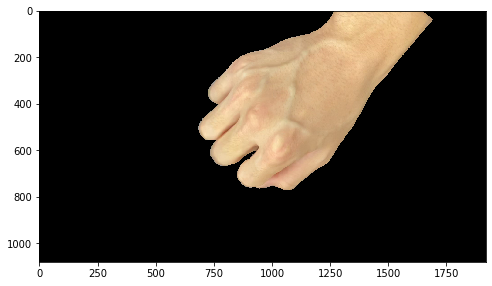

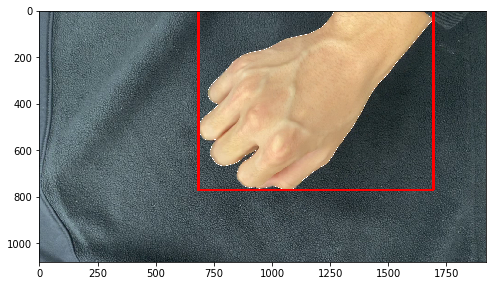

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_21.jpg


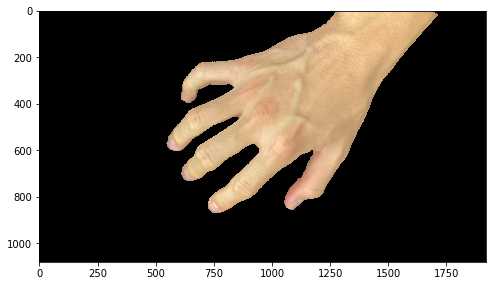

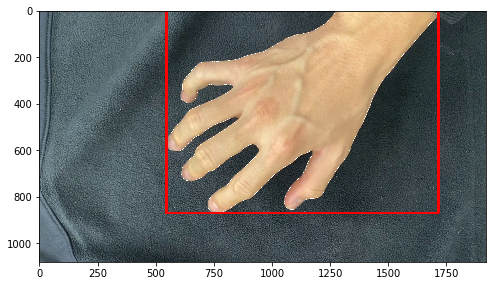

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_22.jpg


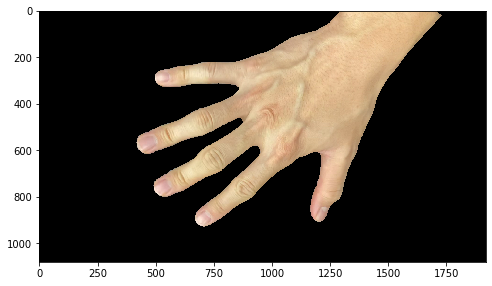

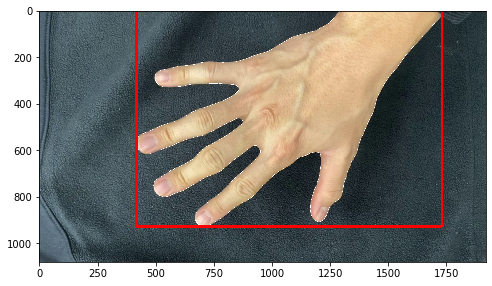

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_23.jpg


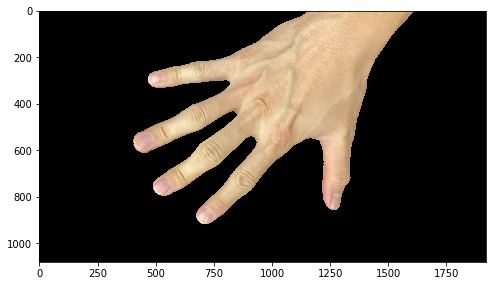

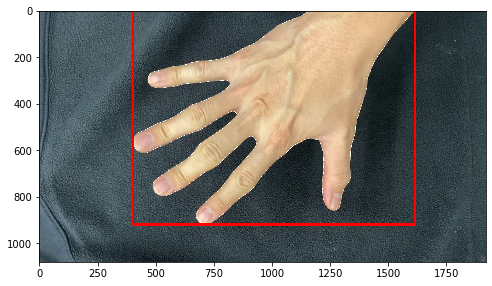

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_24.jpg


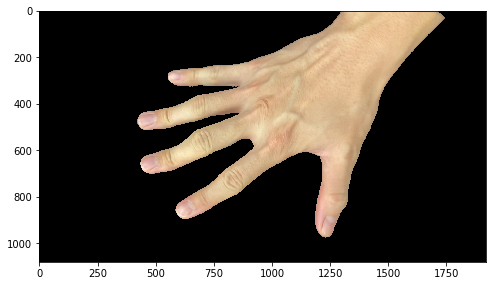

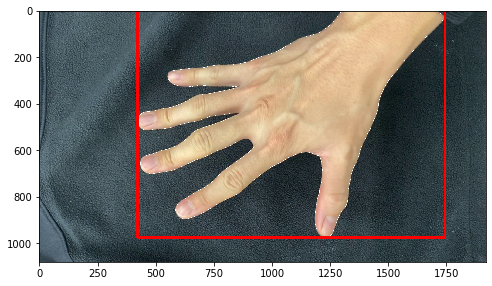

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_25.jpg


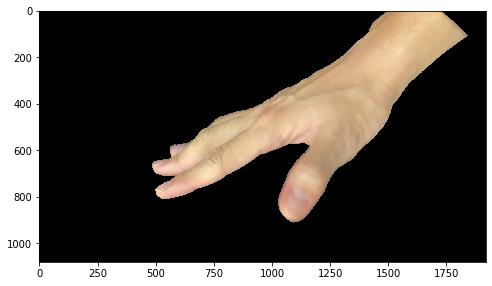

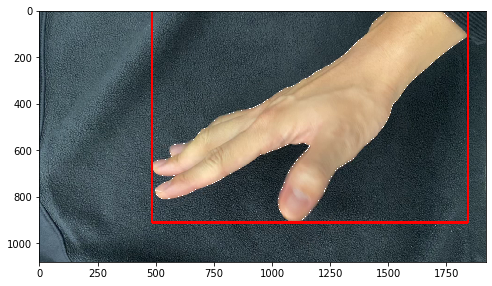

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_26.jpg


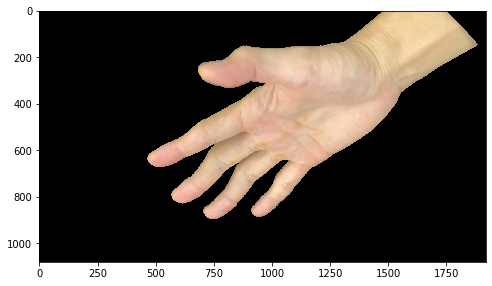

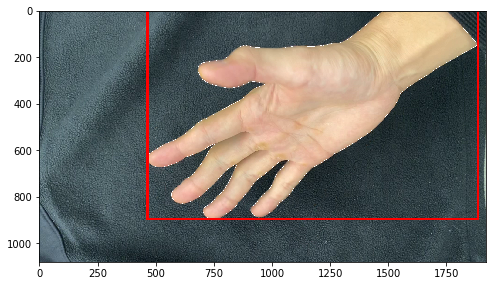

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_27.jpg


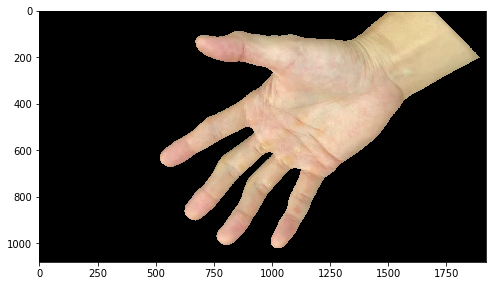

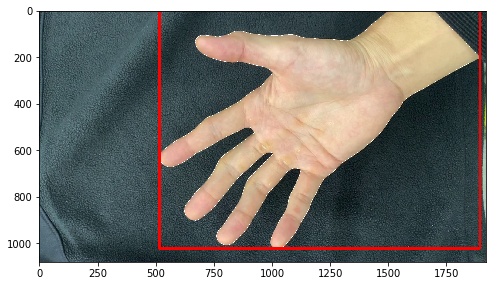

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_28.jpg


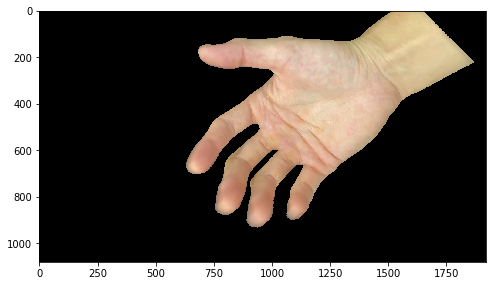

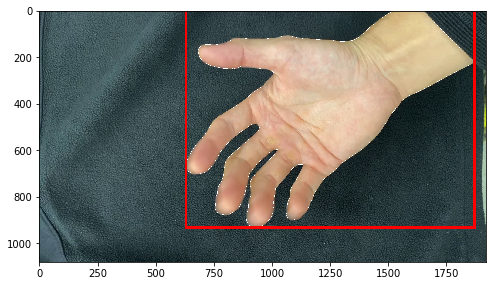

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_29.jpg


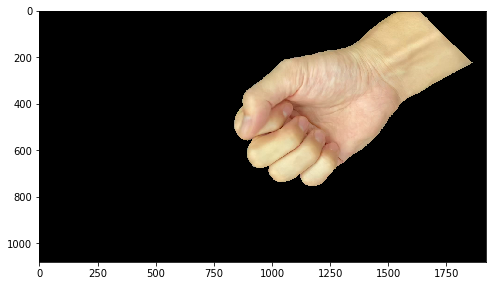

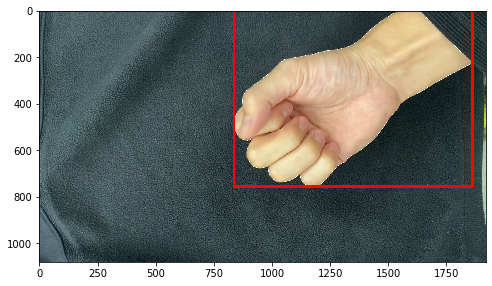

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_30.jpg


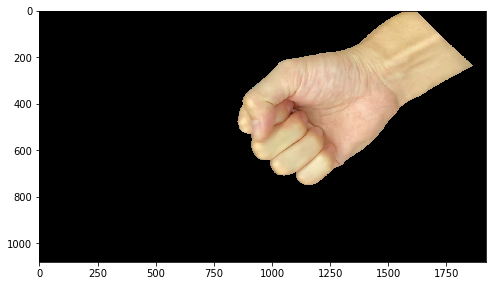

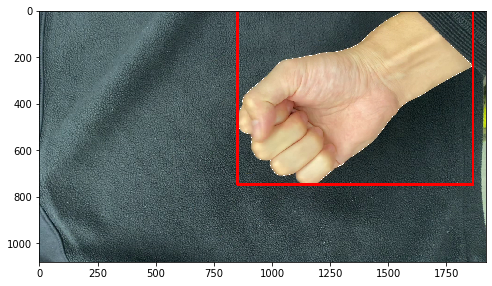

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_31.jpg


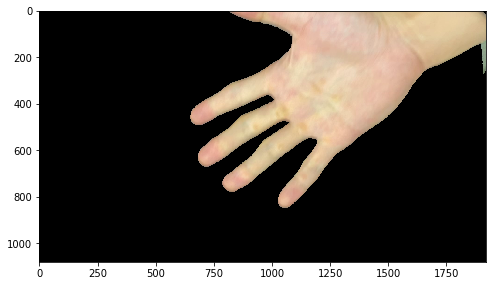

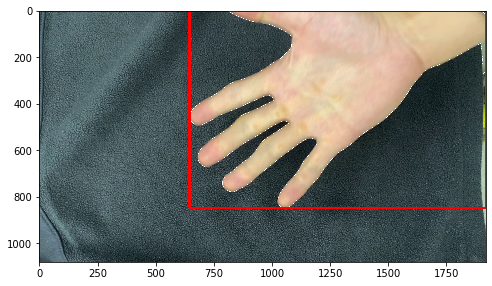

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_32.jpg


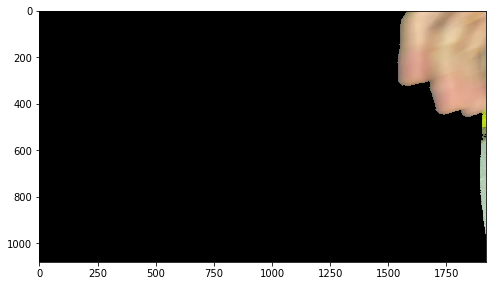

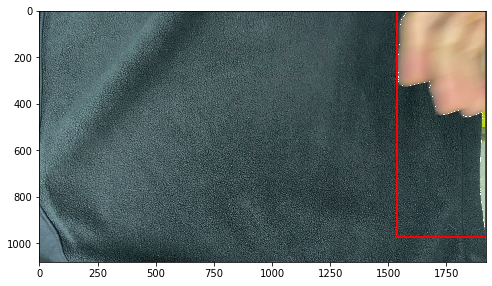

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_33.jpg


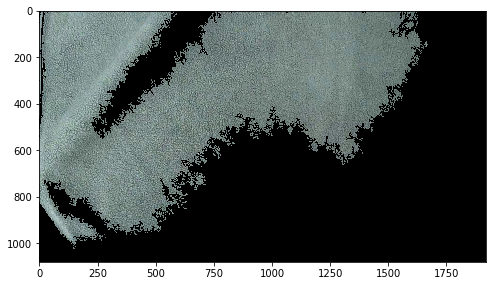

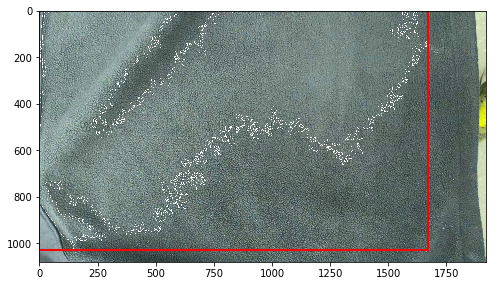

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_34.jpg


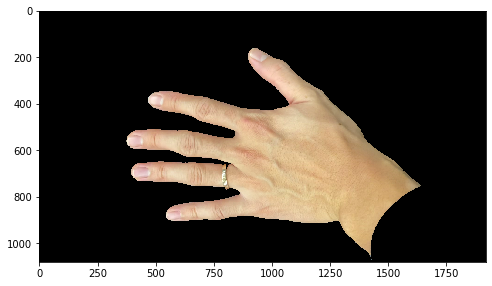

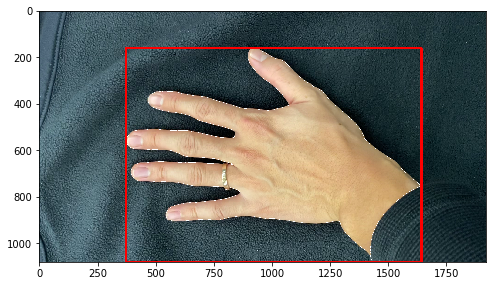

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_35.jpg


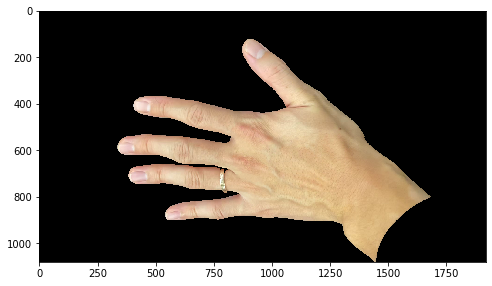

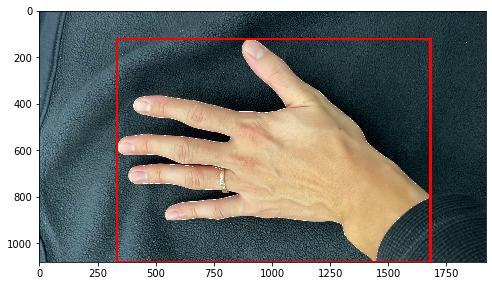

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_36.jpg


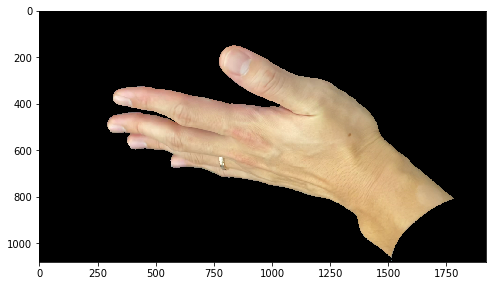

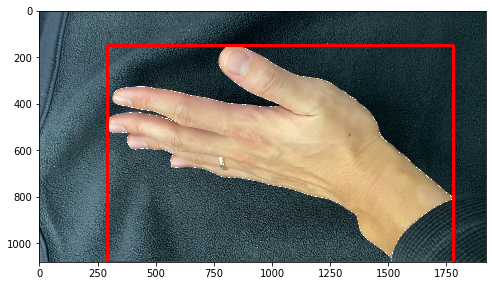

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_37.jpg


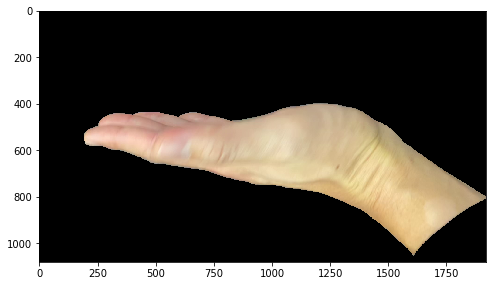

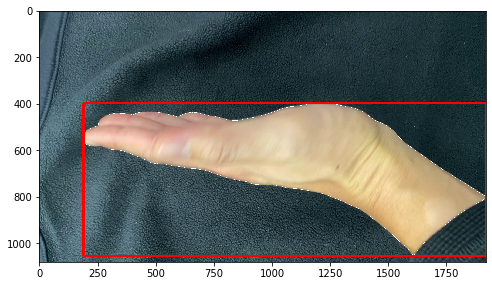

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_38.jpg


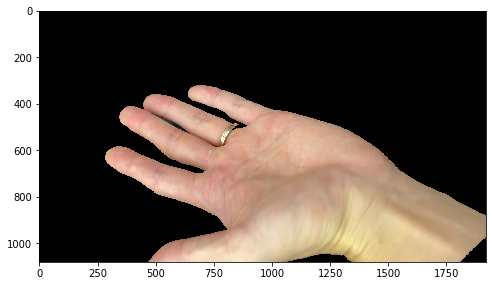

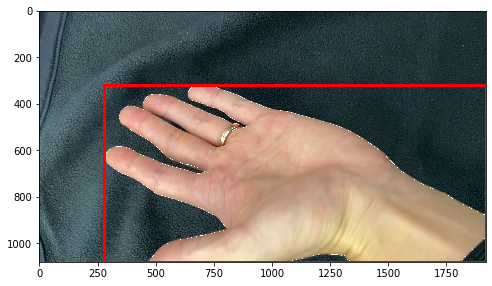

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_39.jpg


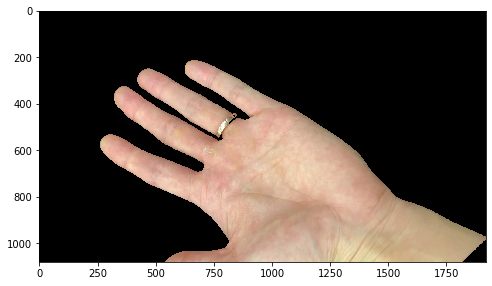

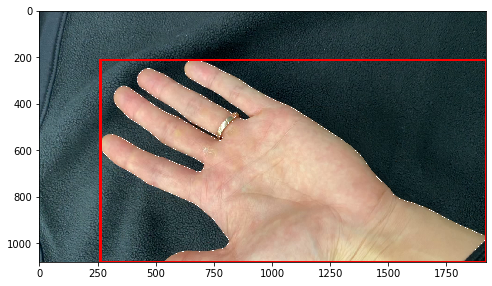

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_40.jpg


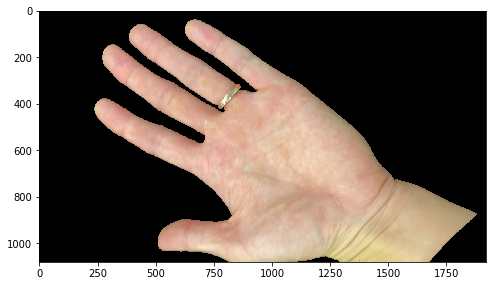

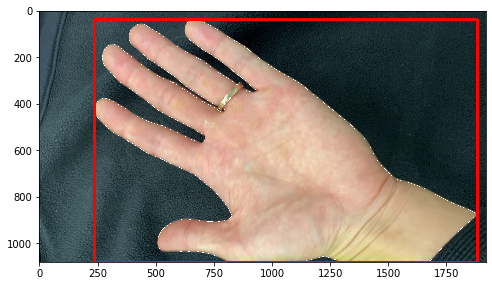

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_41.jpg


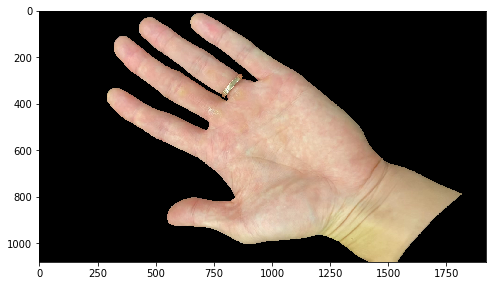

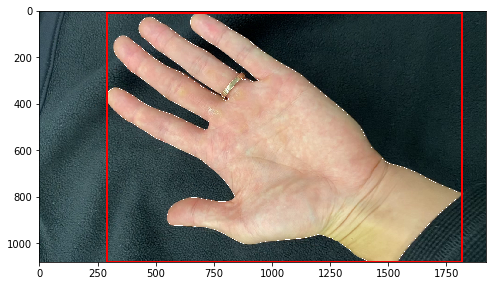

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_42.jpg


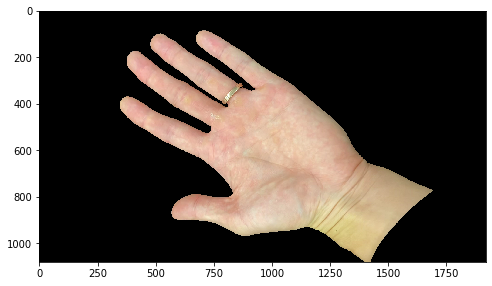

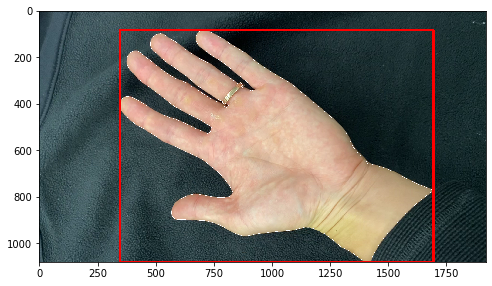

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_43.jpg


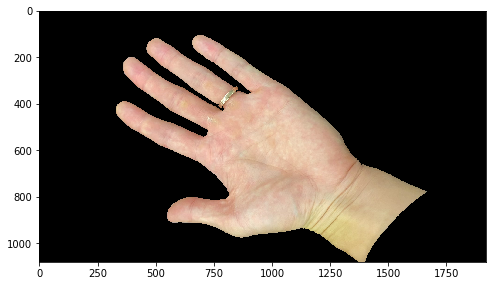

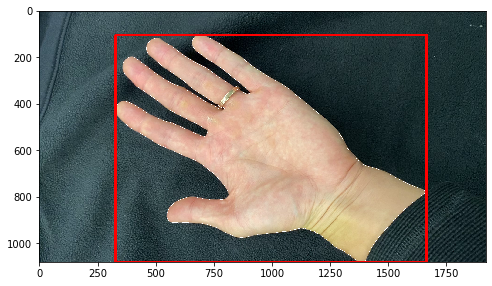

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_44.jpg


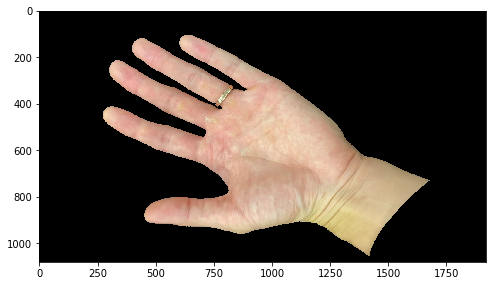

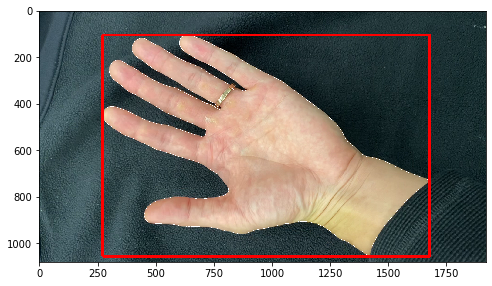

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_45.jpg


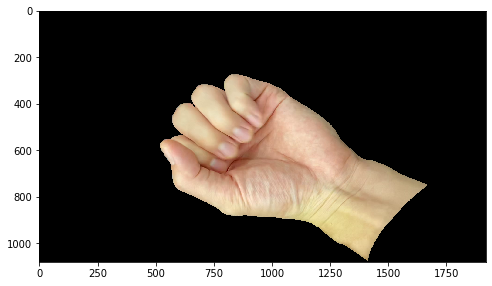

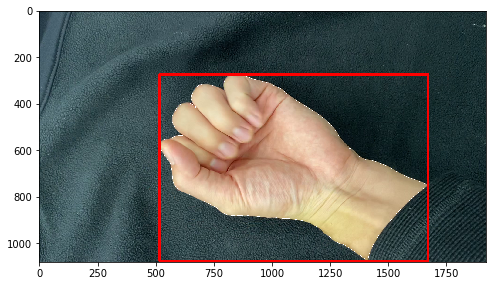

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_46.jpg


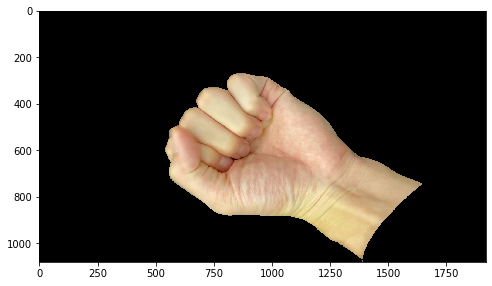

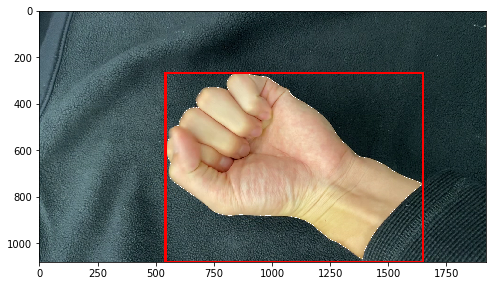

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_47.jpg


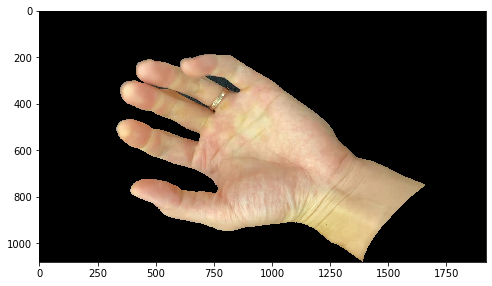

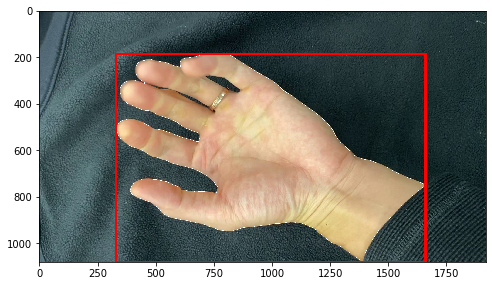

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_48.jpg


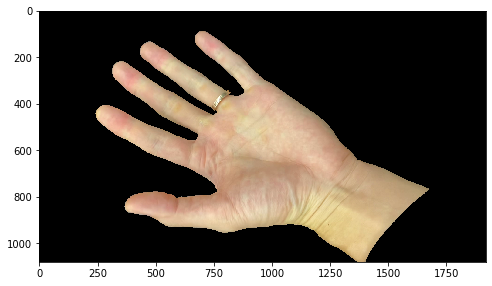

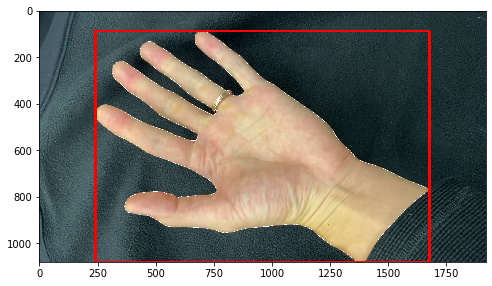

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_49.jpg


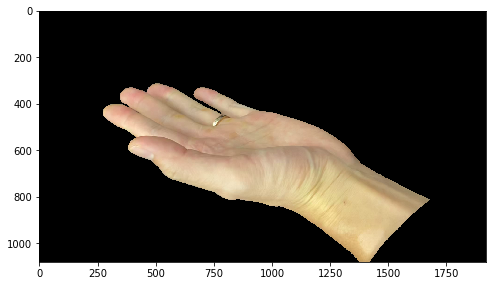

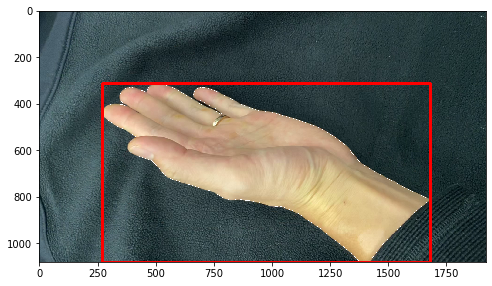

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_50.jpg


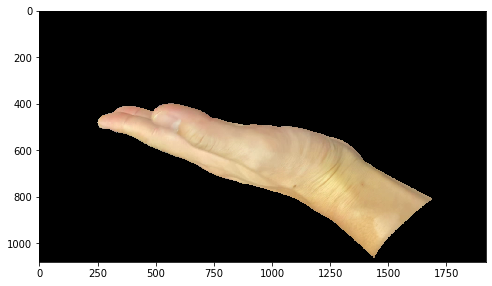

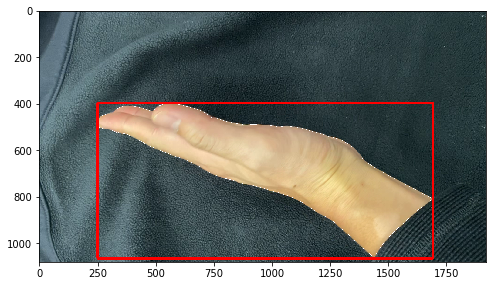

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_51.jpg


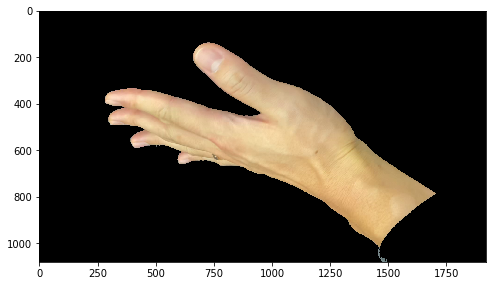

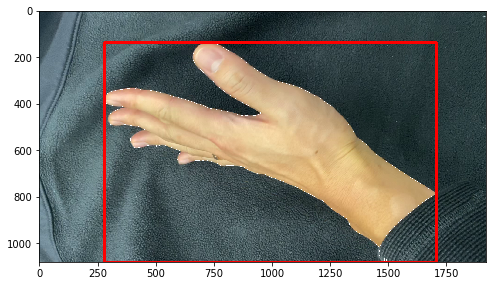

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_52.jpg


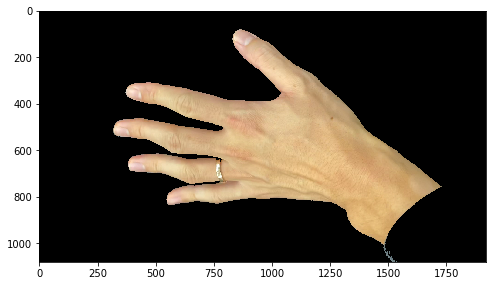

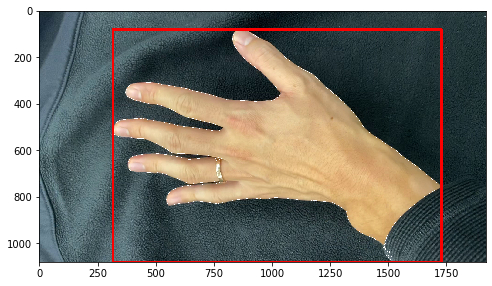

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_53.jpg


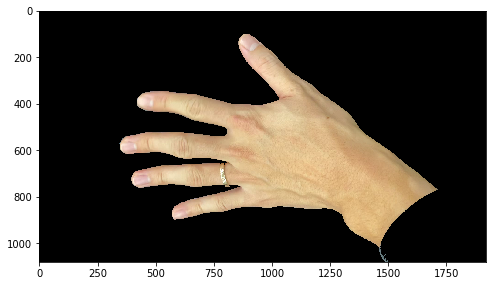

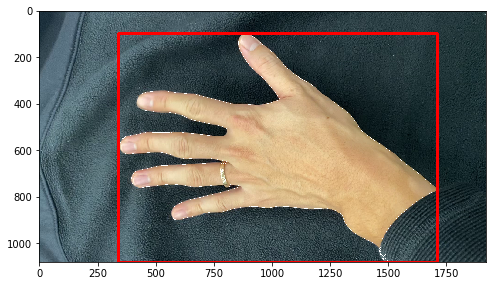

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_54.jpg


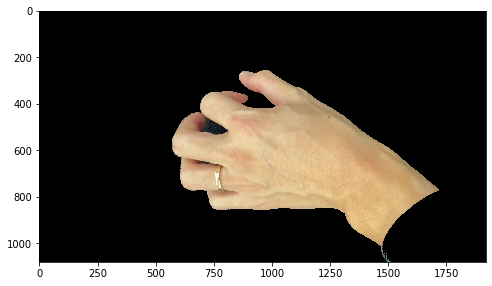

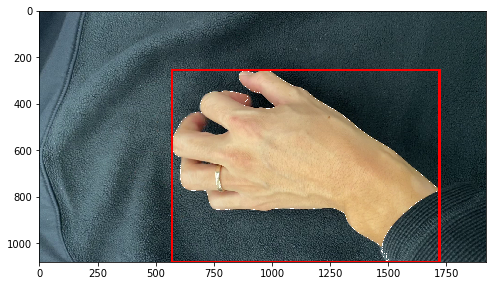

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_55.jpg


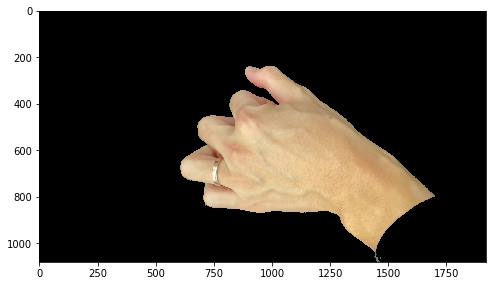

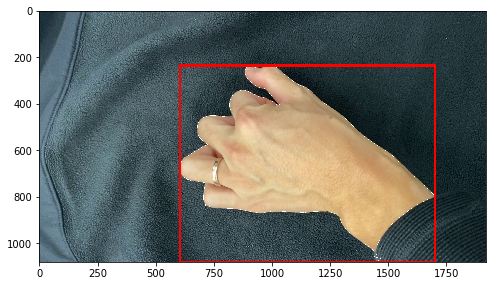

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_56.jpg


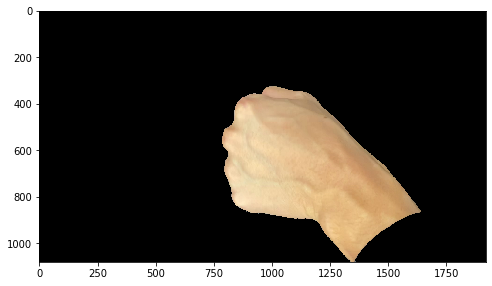

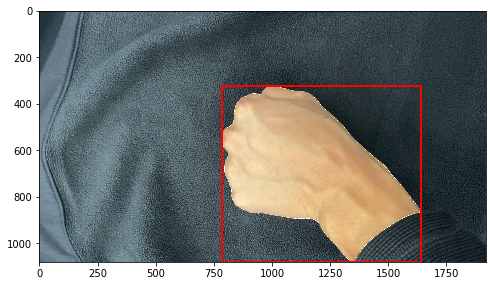

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_57.jpg


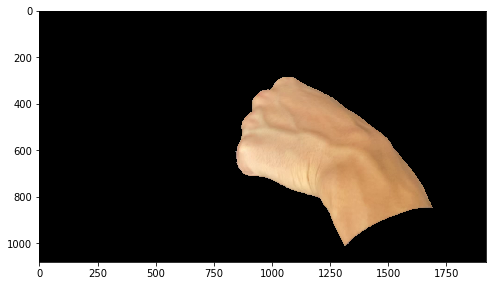

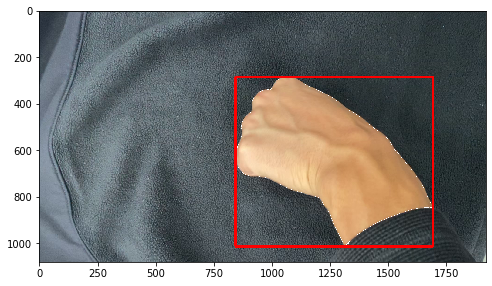

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_58.jpg


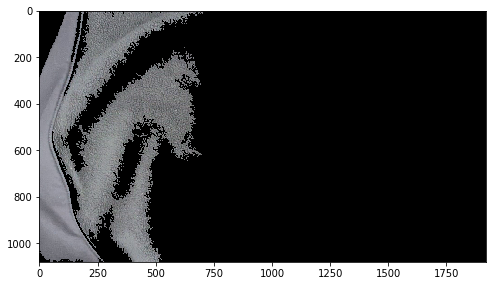

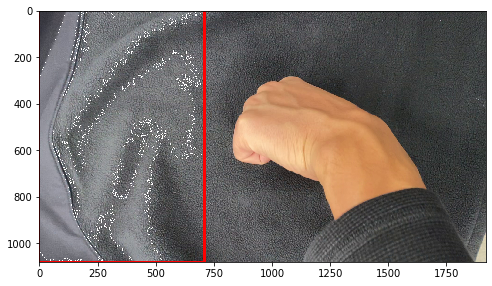

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_59.jpg


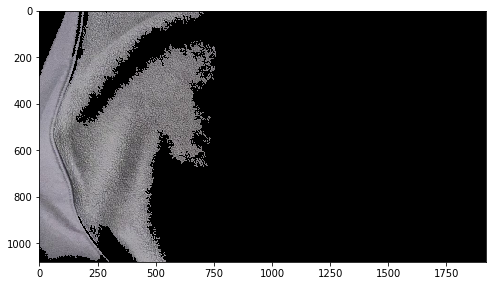

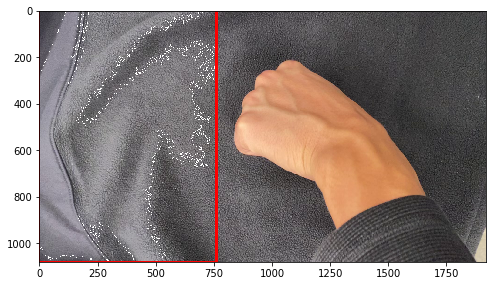

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_60.jpg


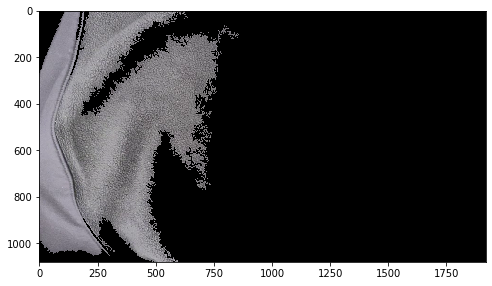

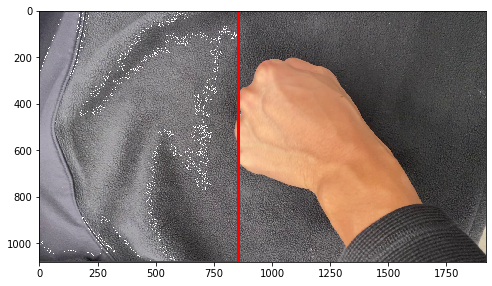

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_61.jpg


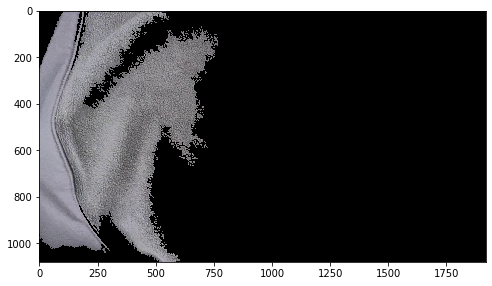

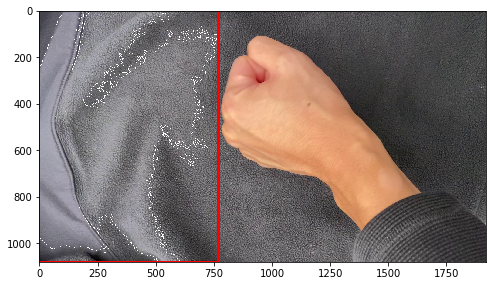

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_62.jpg


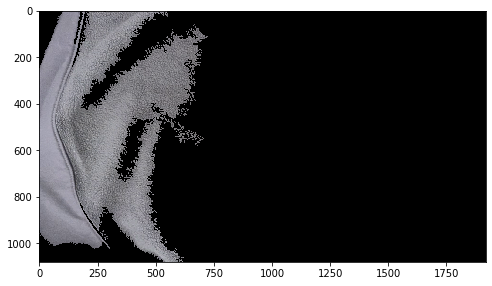

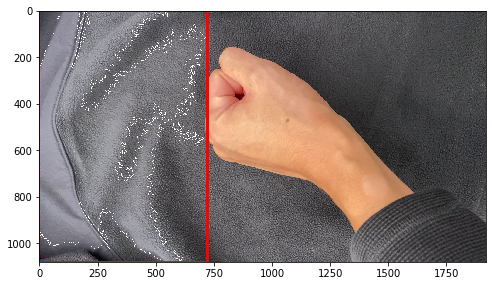

/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_63.jpg


In [54]:
# name of the video files to be processed
filelist = ['IMG_0338.MOV', 'IMG_0341.MOV']

# open the text file to record the coordinates of bouding boxes
f = open('../data/myhand/mask/hand_bbox.txt', 'w+')

# iteration
ind = 0
for video in filelist:
    video = '../data/myhand/' + video
    cap = cv2.VideoCapture(video)
    while True:
        ret, frame = cap.read()
        
        # iterate until EOF
        if ret:
            # process image and extracts contour
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY)[1]
            erode = cv2.erode(thresh, None, iterations=1)
            cnts = cv2.findContours(erode, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            cnts = get_contours(cnts)
            c = max(cnts, key=cv2.contourArea)
            
            # mask generation
            mask = np.zeros((frame.shape[0], frame.shape[1]))
            cv2.drawContours(mask, [c], -1, (1,0,0), cv2.FILLED)
            
            # bounding box
            extLeft = tuple(c[c[:, :, 0].argmin()][0])
            extRight = tuple(c[c[:, :, 0].argmax()][0])
            extTop = tuple(c[c[:, :, 1].argmin()][0])
            extBot = tuple(c[c[:, :, 1].argmax()][0])

            # one in ten frames is to be processed
            if ind % 10 == 0:
                masked = frame.copy()
                for i in range(3):
                    masked[:,:,i] *= (mask!=0)

                cv2.drawContours(frame, [c], -1, (255, 255, 255), 0)
                cv2.rectangle(frame, (extLeft[0], extTop[1]), (extRight[0], extBot[1]), (0, 0, 255), thickness=10) # (0,0,255) is red for opencv
                dre
                # display for visual checking
                showimg(masked, bgr=True)
                showimg(frame, bgr=True)
    
                # save image
                filename = f'/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/hand_mask_{int(ind/10)}.jpg'
                cv2.imwrite(filename, masked)
                
                # print file name in case you want to find the error and get rid of them from the set
                print(filename)
                
                # records the file name and the coordinate of the points in text file
                f.write(f'{filename},{(extLeft[0], extTop[1])},{ (extRight[0], extBot[1])}\n')

            ind += 1
        else:
            break

    # release the videocapture object
    cap.release()

# close the text file
f.close()


After the visual check, I found some of the pictures that didn't have the hand. We want to get rid of them from the data set and the text file.

In [55]:
!rm ../data/myhand/mask/hand_mask_33.jpg
!rm ../data/myhand/mask/hand_mask_34.jpg
!rm ../data/myhand/mask/hand_mask_59.jpg
!rm ../data/myhand/mask/hand_mask_60.jpg
!rm ../data/myhand/mask/hand_mask_61.jpg
!rm ../data/myhand/mask/hand_mask_62.jpg
!rm ../data/myhand/mask/hand_mask_63.jpg

Remove the list of deletion in the hand_bbox.txt as well

In [53]:
MASK_PATH = '/home/jsohn/Documents/_project/handTrackerYolo/data/myhand/'
bbox_file = 'mask/hand_bbox.txt'
!ls /home/jsohn/Documents/_project/handTrackerYolo/data/myhand/mask/

hand_bbox.txt	  hand_mask_22.jpg  hand_mask_38.jpg  hand_mask_51.jpg
hand_mask_0.jpg   hand_mask_23.jpg  hand_mask_39.jpg  hand_mask_52.jpg
hand_mask_10.jpg  hand_mask_24.jpg  hand_mask_3.jpg   hand_mask_53.jpg
hand_mask_11.jpg  hand_mask_25.jpg  hand_mask_40.jpg  hand_mask_54.jpg
hand_mask_12.jpg  hand_mask_26.jpg  hand_mask_41.jpg  hand_mask_55.jpg
hand_mask_13.jpg  hand_mask_27.jpg  hand_mask_42.jpg  hand_mask_56.jpg
hand_mask_14.jpg  hand_mask_28.jpg  hand_mask_43.jpg  hand_mask_57.jpg
hand_mask_15.jpg  hand_mask_29.jpg  hand_mask_44.jpg  hand_mask_58.jpg
hand_mask_16.jpg  hand_mask_2.jpg   hand_mask_45.jpg  hand_mask_5.jpg
hand_mask_17.jpg  hand_mask_30.jpg  hand_mask_46.jpg  hand_mask_6.jpg
hand_mask_18.jpg  hand_mask_31.jpg  hand_mask_47.jpg  hand_mask_7.jpg
hand_mask_19.jpg  hand_mask_32.jpg  hand_mask_48.jpg  hand_mask_8.jpg
hand_mask_1.jpg   hand_mask_35.jpg  hand_mask_49.jpg  hand_mask_9.jpg
hand_mask_20.jpg  hand_mask_36.jpg  hand_mask_4.jpg
hand_mask_21.jpg  hand_mask_37.j